In [1]:
import numpy as np
import akin
import datasketch
import pandas as pd
from tqdm import tqdm
from sklearn.preprocessing import MultiLabelBinarizer
from skmultilearn.model_selection import iterative_train_test_split

In [3]:
def read_nihr_dataset():
    nihr_df = pd.read_parquet(
        '../data/raw/nihr_all.parquet',
        columns=[
            'project_id',
            'project_title',
            'scientific_abstract',
            'ukcrc_value',
            'hrcs_rac_category',
            'ukcrc_value_rac'
        ]
    )

    clean_df = nihr_df.loc[
        ~nihr_df['ukcrc_value_rac'].str.split().str[0].isin(['9.1', '9.2'])
    ]

    clean_df = clean_df.loc[clean_df['hrcs_rac_category'].str.split().str[0] != '9.']
    clean_df = clean_df.loc[clean_df['hrcs_rac_category'] != 'None']
    clean_df = clean_df.loc[clean_df['hrcs_rac_category'].str.split().str[0] != 'None']

    null_hcs = [
        'Awaiting Health Category Coding',
        'Will Not Be Health Category Coded'
    ]

    clean_df.where(clean_df['ukcrc_value'].isin(null_hcs), None)

    clean_df['ukcrc_value'] = clean_df['ukcrc_value'].str.split(',')
    clean_df['hrcs_rac_category'] = clean_df['hrcs_rac_category'].str.split('/')
    clean_df['ukcrc_value_rac'] = clean_df['ukcrc_value_rac'].str.split('/')

    clean_df = clean_df.dropna(subset=['hrcs_rac_category', 'ukcrc_value_rac'])

    clean_df['hrcs_rac_category'] = clean_df['hrcs_rac_category'].apply(
        lambda lst: [s.split()[0][:-1] for s in lst]
    )

    clean_df['ukcrc_value_rac'] = clean_df['ukcrc_value_rac'].apply(
        lambda lst: [s.split()[0] for s in lst]
    )

    col_names = {
        'ukcrc_value': 'HC',
        'hrcs_rac_category': 'RA_top',
        'ukcrc_value_rac': 'RA',
        'project_title': 'AwardTitle',
        'scientific_abstract': 'AwardAbstract'
    }

    clean_df.rename(columns=col_names, inplace=True)

    return clean_df


read_nihr_dataset()

,project_id,AwardTitle,AwardAbstract,HC,RA_top,RA
0,001/0009,Moving From Observation to Intervention to Red...,BackgroundThis is a programme of linked multi-...,[Injuries and Accidents],"[3, 7]","[3.2, 7.1]"
3,002/0025,Pilot Study of Risks and Long Term Effects of ...,"Background In non-fatal CO poisoning, there...",[Injuries and Accidents],"[7, 2]","[7.1, 2.4]"
4,002/0027,Health Implications of Polycyclic Aromatic Hyd...,BackgroundPolycyclic aromatic hydrocarbons are...,[Cancer and neoplasms],[2],[2.5]
5,002/0029,Life Course Effects of Air Pollution (LEAP) on...,BackgroundThere is persuasive evidence linking...,[Injuries and Accidents],[2],[2.4]
6,002/0031,Oxidative Potential of Particulate Matter and ...,"BackgroundTo date, the majority of evidence ab...",[Generic Health Relevance],[2],[2.2]
...,...,...,...,...,...,...
10135,SRF-2015-08-005,Cerebral visual impairment in primary school a...,"Background, Aim and Research Questions Cerebr...","[Eye, Neurological]","[4, 7]","[4.3, 7.1]"
10136,TRF-2013-06-003,TRF Award,Training Award,[Cancer and neoplasms],"[4, 4]","[4.4, 4.2]"
10137,TRF-2014-07-003,Do diabetic patients with periodontitis benefi...,Objectives Diabetes carries a high risk of mor...,"[Oral and Gastrointestinal, Metabolic and Endo...",[7],[7.1]
10138,TRF-2014-07-009,"Public, patient and parent involvement in clin...",Background: Data from observational studies ar...,[Reproductive Health and Childbirth],[1],[1.1]


In [3]:
df = pd.read_parquet('../data/raw/nihr_all.parquet')
df.head()

,project_id,project_title,funding_and_awards_link,funder,project_status,programme,programme_type,programme_stream,funding_stream,award_amount_from_dh,...,award_amount_m,acronym,award_holder_name,orcid,involvement_type,ukcrc_value,hrcs_rac_category,ukcrc_value_rac,categorytype,institutioncountry
0,001/0009,Moving From Observation to Intervention to Red...,https://fundingawards.nihr.ac.uk/award/001/0009,NIHR (non-ODA),Complete,Policy Research Programme,Research,Researcher Led,Policy Research Programme,670528.0,...,0.670528,PRP,Professor Ronan Lyons,0000-0001-5225-000X,Chief Investigator,Injuries and Accidents,"3. Prevention of Disease and Conditions, and P...",3.2 Interventions to alter physical and biolog...,Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
1,001/0012,"Accidental Injury, Risk Taking Behaviour and t...",https://fundingawards.nihr.ac.uk/award/001/0012,NIHR (non-ODA),Complete,Policy Research Programme,Research,Researcher Led,Policy Research Programme,179739.0,...,0.179739,PRP,Professor James Thomas,0000-0003-4805-4190,Chief Investigator,Awaiting Health Category Coding,9. Awaiting RAC Coding,9.1 Awaiting RAC Coding,Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
2,001/0020,Accidental Injury: Programme Coordination,https://fundingawards.nihr.ac.uk/award/001/0020,NIHR (non-ODA),Complete,Policy Research Programme,Research,Researcher Led,Policy Research Programme,62113.0,...,0.062113,PRP,Ms Christine McGuire,Not Provided,Chief Investigator,Awaiting Health Category Coding,9. Awaiting RAC Coding,9.1 Awaiting RAC Coding,Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
3,002/0025,Pilot Study of Risks and Long Term Effects of ...,https://fundingawards.nihr.ac.uk/award/002/0025,NIHR (non-ODA),Complete,Policy Research Programme,Research,Researcher Led,Policy Research Programme,65415.0,...,0.065415,PRP,Dr Brian Miller,Not Provided,Chief Investigator,Injuries and Accidents,7. Management of Diseases and Conditions/2. Ae...,7.1 Individual care needs/2.4 Surveillance and...,Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
4,002/0027,Health Implications of Polycyclic Aromatic Hyd...,https://fundingawards.nihr.ac.uk/award/002/0027,NIHR (non-ODA),Complete,Policy Research Programme,Research,Researcher Led,Policy Research Programme,74730.0,...,0.074730,PRP,Professor Roy Harrison,Not Provided,Chief Investigator,Cancer and neoplasms,2. Aetiology,2.5 Research design and methodology (aetiology),Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner


In [4]:
df.loc[df['hrcs_rac_category'].str.split().str[0] != '9.']

,project_id,project_title,funding_and_awards_link,funder,project_status,programme,programme_type,programme_stream,funding_stream,award_amount_from_dh,...,award_amount_m,acronym,award_holder_name,orcid,involvement_type,ukcrc_value,hrcs_rac_category,ukcrc_value_rac,categorytype,institutioncountry
0,001/0009,Moving From Observation to Intervention to Red...,https://fundingawards.nihr.ac.uk/award/001/0009,NIHR (non-ODA),Complete,Policy Research Programme,Research,Researcher Led,Policy Research Programme,670528.00,...,0.670528,PRP,Professor Ronan Lyons,0000-0001-5225-000X,Chief Investigator,Injuries and Accidents,"3. Prevention of Disease and Conditions, and P...",3.2 Interventions to alter physical and biolog...,Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
3,002/0025,Pilot Study of Risks and Long Term Effects of ...,https://fundingawards.nihr.ac.uk/award/002/0025,NIHR (non-ODA),Complete,Policy Research Programme,Research,Researcher Led,Policy Research Programme,65415.00,...,0.065415,PRP,Dr Brian Miller,Not Provided,Chief Investigator,Injuries and Accidents,7. Management of Diseases and Conditions/2. Ae...,7.1 Individual care needs/2.4 Surveillance and...,Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
4,002/0027,Health Implications of Polycyclic Aromatic Hyd...,https://fundingawards.nihr.ac.uk/award/002/0027,NIHR (non-ODA),Complete,Policy Research Programme,Research,Researcher Led,Policy Research Programme,74730.00,...,0.074730,PRP,Professor Roy Harrison,Not Provided,Chief Investigator,Cancer and neoplasms,2. Aetiology,2.5 Research design and methodology (aetiology),Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
5,002/0029,Life Course Effects of Air Pollution (LEAP) on...,https://fundingawards.nihr.ac.uk/award/002/0029,NIHR (non-ODA),Complete,Policy Research Programme,Research,Researcher Led,Policy Research Programme,170556.00,...,0.170556,PRP,Professor Anna Hansell,0000-0001-9904-7447,Chief Investigator,Injuries and Accidents,2. Aetiology,2.4 Surveillance and distribution,Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
6,002/0031,Oxidative Potential of Particulate Matter and ...,https://fundingawards.nihr.ac.uk/award/002/0031,NIHR (non-ODA),Complete,Policy Research Programme,Research,Researcher Led,Policy Research Programme,151432.00,...,0.151432,PRP,Professor Frank Kelly,0000-0003-2558-8392,Chief Investigator,Generic Health Relevance,2. Aetiology,2.2 Factors relating to physical environment,Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10135,SRF-2015-08-005,Cerebral visual impairment in primary school a...,https://fundingawards.nihr.ac.uk/award/SRF-201...,NIHR (non-ODA),Complete,NIHR Fellowships,Training,Trainee Development,Senior Research Fellowship,1054890.00,...,1.054890,NIHR Fellowships,Ms Cathy Williams,0000-0002-9133-2021,Award Holder,"Eye,Neurological","4. Detection, Screening and Diagnosis/7. Manag...",4.3 Influences and impact/7.1 Individual care ...,Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
10136,TRF-2013-06-003,TRF Award,https://fundingawards.nihr.ac.uk/award/TRF-201...,NIHR (non-ODA),Complete,NIHR Fellowships,Training,Trainee Development,Transitional Research Fellowship,158772.58,...,0.158773,NIHR Fellowships,Dr Araminta Ledger,Not Provided,Award Holder,Cancer and neoplasms,"4. Detection, Screening and Diagnosis/4. Detec...",4.4 Population screening/4.2 Evaluation of mar...,Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
10137,TRF-2014-07-003,Do diabetic patients with periodontitis benefi...,https://fundingawards.nihr.ac.uk/award/TRF-201...,NIHR (non-ODA),Complete,NIHR Fellowships,Training,Trainee Development,Transitional Research Fellowship,139270.36,...,0.139270,

In [5]:
df.loc[df['hrcs_rac_category'] == 'None']

,project_id,project_title,funding_and_awards_link,funder,project_status,programme,programme_type,programme_stream,funding_stream,award_amount_from_dh,...,award_amount_m,acronym,award_holder_name,orcid,involvement_type,ukcrc_value,hrcs_rac_category,ukcrc_value_rac,categorytype,institutioncountry
215,09/104/40,Health-Related Quality of Life in two treatmen...,https://fundingawards.nihr.ac.uk/award/09/104/40,NIHR (non-ODA),Complete,Health Technology Assessment,Research,Researcher Led,HTA Clinical Trials & Evaluation,1953945.00,...,1.953945,HTA,Professor Gus Gazzard,0000-0003-1982-5005,Chief Investigator,Eye,None,6.5 Radiotherapy and other non-invasive therapies,Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
282,10/104/07,TARGIT-B: An international randomised controll...,https://fundingawards.nihr.ac.uk/award/10/104/07,NIHR (non-ODA),Active,Health Technology Assessment,Research,Researcher Led,HTA Clinical Trials & Evaluation,1560620.46,...,1.560620,HTA,Professor Jayant Vaidya,0000-0003-1760-1278,Chief Investigator,Cancer and neoplasms,None,6.5 Radiotherapy and other non-invasive therapies,Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
345,11/2000/05,The detection and management of pain in patien...,https://fundingawards.nihr.ac.uk/award/11/2000/05,NIHR (non-ODA),Complete,Health and Social Care Delivery Research,Research,Researcher Led,HSDR Researcher Led,755993.76,...,0.755994,HSDR,Professor José Closs,0000-0002-3257-5277,Chief Investigator,Mental Health,None,5.9 Resources and infrastructure (treatment de...,Dementia,Award does not have an ODA Downstream Partner
379,12/127/127,Catheter Ablation Versus Thoracoscopic Surgica...,https://fundingawards.nihr.ac.uk/award/12/127/127,Non-NIHR funding,Complete,Efficacy and Mechanism Evaluation,Research,Researcher Led,EME Researcher Led,1377871.50,...,1.377871,EME,Dr Tom Wong,0000-0002-6484-4961,Chief Investigator,Cardiovascular,None,6.5 Radiotherapy and other non-invasive therapies,Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
635,15/125/01,EQUATOR Network,https://fundingawards.nihr.ac.uk/award/15/125/01,NIHR (non-ODA),Complete,Health Technology Assessment,Research,Commissioned,HTA Customer Priority Research,117000.00,...,0.117000,HTA,Professor Douglas Altman,Not Provided,Chief Investigator,Will Not Be Health Category Coded,None,9.2 Will Not Be RAC Coded,Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10127,SPARC-05-18-07,NIHR Short Placement Award for Research Collab...,https://fundingawards.nihr.ac.uk/award/SPARC-0...,NIHR (non-ODA),Complete,NIHR Bridging and Short Term Support,Training,Trainee Development,Short Placement Award for Research Collaboration,2342.50,...,0.002342,None,Miss Shazmin Majid,Not Provided,Award Holder,Will Not Be Health Category Coded,None,9.2 Will Not Be RAC Coded,Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
10128,SPARC-05-18-10,NIHR Short Placement Award for Research Collab...,https://fundingawards.nihr.ac.uk/award/SPARC-0...,NIHR (non-ODA),Complete,NIHR Bridging and Short Term Support,Training,Trainee Development,Short Placement Award for Research Collaboration,2750.00,...,0.002750,None,Ms Roulla Katiri,Not Provided,Award Holder,Will Not Be Health Category Coded,None,9.2 Will Not Be RAC Coded,Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
10129,SPARC-06-19-05,NIHR Short Placement Award for Research Collab...,https://fundingawards.nihr.ac.uk/award/SPARC-0...,NIHR (non-ODA),Complete,NIHR Bridging and Short Term Support,Training,Trainee Development,Short Placement Award for Research Collaboration,3170.00,...,0.003170,None,Miss Carmel McGrath,Not Provided,Award Holder,Will Not Be Health Category Coded,None,9.2 Will Not Be RAC Coded,Award not coded to a cu

In [6]:
for i in df['hrcs_rac_category'].value_counts().index:
    print(i)

None
6. Evaluation of Treatments and Therapeutic Interventions
8. Health and Social Care Services Research
7. Management of Diseases and Conditions
9. Awaiting RAC Coding
4. Detection, Screening and Diagnosis
3. Prevention of Disease and Conditions, and Promotion of Well-Being
7. Management of Diseases and Conditions/8. Health and Social Care Services Research
5. Development of Treatments and Therapeutic Interventions
8. Health and Social Care Services Research/8. Health and Social Care Services Research
7. Management of Diseases and Conditions/7. Management of Diseases and Conditions
2. Aetiology
5. Development of Treatments and Therapeutic Interventions/6. Evaluation of Treatments and Therapeutic Interventions
6. Evaluation of Treatments and Therapeutic Interventions/6. Evaluation of Treatments and Therapeutic Interventions
8. Health and Social Care Services Research/7. Management of Diseases and Conditions
6. Evaluation of Treatments and Therapeutic Interventions/7. Management of Di

In [7]:
def clean_nihr_dataset(df):
    clean_df = df.loc[~df['ukcrc_value_rac'].str.split().str[0].isin(['9.1', '9.2'])]
    clean_df = clean_df.loc[clean_df['hrcs_rac_category'].str.split().str[0] != '9.']
    clean_df = clean_df.loc[clean_df['hrcs_rac_category'] != 'None']
    clean_df = clean_df.loc[clean_df['hrcs_rac_category'].str.split().str[0] != 'None']
    null_hcs = ['Awaiting Health Category Coding', 'Will Not Be Health Category Coded']
    clean_df.where(clean_df['ukcrc_value'].isin(null_hcs), None)

    clean_df['ukcrc_value'] = clean_df['ukcrc_value'].str.split(', ')
    clean_df['hrcs_rac_category'] = clean_df['hrcs_rac_category'].str.split('/')
    clean_df['ukcrc_value_rac'] = clean_df['ukcrc_value_rac'].str.split('/')

    return clean_df


clean_df = clean_nihr_dataset(df)
clean_df

,project_id,project_title,funding_and_awards_link,funder,project_status,programme,programme_type,programme_stream,funding_stream,award_amount_from_dh,...,award_amount_m,acronym,award_holder_name,orcid,involvement_type,ukcrc_value,hrcs_rac_category,ukcrc_value_rac,categorytype,institutioncountry
0,001/0009,Moving From Observation to Intervention to Red...,https://fundingawards.nihr.ac.uk/award/001/0009,NIHR (non-ODA),Complete,Policy Research Programme,Research,Researcher Led,Policy Research Programme,670528.00,...,0.670528,PRP,Professor Ronan Lyons,0000-0001-5225-000X,Chief Investigator,[Injuries and Accidents],"[3. Prevention of Disease and Conditions, and ...",[3.2 Interventions to alter physical and biolo...,Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
3,002/0025,Pilot Study of Risks and Long Term Effects of ...,https://fundingawards.nihr.ac.uk/award/002/0025,NIHR (non-ODA),Complete,Policy Research Programme,Research,Researcher Led,Policy Research Programme,65415.00,...,0.065415,PRP,Dr Brian Miller,Not Provided,Chief Investigator,[Injuries and Accidents],"[7. Management of Diseases and Conditions, 2. ...","[7.1 Individual care needs, 2.4 Surveillance a...",Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
4,002/0027,Health Implications of Polycyclic Aromatic Hyd...,https://fundingawards.nihr.ac.uk/award/002/0027,NIHR (non-ODA),Complete,Policy Research Programme,Research,Researcher Led,Policy Research Programme,74730.00,...,0.074730,PRP,Professor Roy Harrison,Not Provided,Chief Investigator,[Cancer and neoplasms],[2. Aetiology],[2.5 Research design and methodology (aetiology)],Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
5,002/0029,Life Course Effects of Air Pollution (LEAP) on...,https://fundingawards.nihr.ac.uk/award/002/0029,NIHR (non-ODA),Complete,Policy Research Programme,Research,Researcher Led,Policy Research Programme,170556.00,...,0.170556,PRP,Professor Anna Hansell,0000-0001-9904-7447,Chief Investigator,[Injuries and Accidents],[2. Aetiology],[2.4 Surveillance and distribution],Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
6,002/0031,Oxidative Potential of Particulate Matter and ...,https://fundingawards.nihr.ac.uk/award/002/0031,NIHR (non-ODA),Complete,Policy Research Programme,Research,Researcher Led,Policy Research Programme,151432.00,...,0.151432,PRP,Professor Frank Kelly,0000-0003-2558-8392,Chief Investigator,[Generic Health Relevance],[2. Aetiology],[2.2 Factors relating to physical environment],Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10135,SRF-2015-08-005,Cerebral visual impairment in primary school a...,https://fundingawards.nihr.ac.uk/award/SRF-201...,NIHR (non-ODA),Complete,NIHR Fellowships,Training,Trainee Development,Senior Research Fellowship,1054890.00,...,1.054890,NIHR Fellowships,Ms Cathy Williams,0000-0002-9133-2021,Award Holder,"[Eye,Neurological]","[4. Detection, Screening and Diagnosis, 7. Man...","[4.3 Influences and impact, 7.1 Individual car...",Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
10136,TRF-2013-06-003,TRF Award,https://fundingawards.nihr.ac.uk/award/TRF-201...,NIHR (non-ODA),Complete,NIHR Fellowships,Training,Trainee Development,Transitional Research Fellowship,158772.58,...,0.158773,NIHR Fellowships,Dr Araminta Ledger,Not Provided,Award Holder,[Cancer and neoplasms],"[4. Detection, Screening and Diagnosis, 4. Det...","[4.4 Population screening, 4.2 Evaluation of m...",Award not coded to a curated portfolio,Award does not have an ODA Downstream Partner
10137,TRF-2014-07-003,Do diabetic patients with periodontitis benefi...,https://fundingawards.nihr.ac.uk/award/TRF-201...,NIHR (non-ODA),Complete,NIHR Fellowships,Training,Trainee Development,Transitional Research 

In [8]:
counts = clean_df[['ukcrc_value_rac']].explode('ukcrc_value_rac')
counts['count'] = 1
counts = counts.groupby('ukcrc_value_rac', as_index=False).sum()
counts.sort_values(by='count', inplace=True)
counts.head()

,ukcrc_value_rac,count
27,5.8 Complementary,4
28,5.9 Resources and infrastructure (treatment de...,8
3,1.5 Resources and infrastructure (underpinning),9
1,1.2 Psychological and socioeconomic processes,10
0,1.1 Normal biological development and functioning,12


<Axes: ylabel='ukcrc_value_rac'>

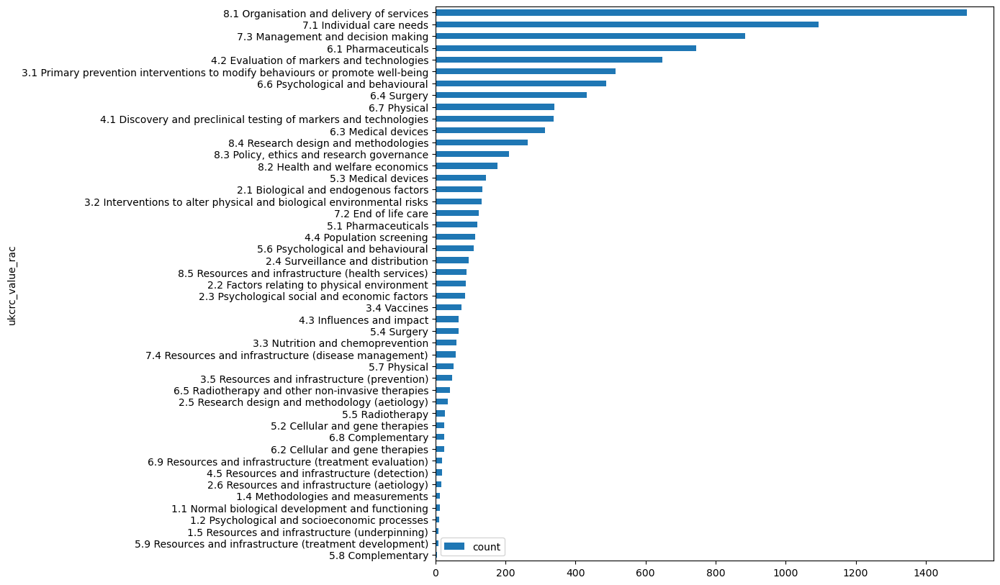

In [9]:
counts.plot.barh(x='ukcrc_value_rac', y='count', figsize=(10, 10))

In [4]:
all_df = pd.read_parquet('../data/clean/clean.parquet')
all_df

,FundingOrganisation,OrganisationReference,RA,RA_top,HC,AllText
0,Action Medical Research,GN1945,[4.2],[4],[neurological],Over 2 years to investigate improved detection...
1,Action Medical Research,GN1890,[5.6],[5],[mental health],Over 30 months to study real-time fMRI Neurofe...
2,Action Medical Research,2080,"[2.1, 2.3]",[2],[mental health],Over three years to investigate preterm birth ...
3,Action Medical Research,1999,"[2.1, 5.1]","[5, 2]",[disputed aetiology and other],Over three years for investigation of manganes...
4,Action Medical Research,2008,"[2.1, 4.1]","[4, 2]","[metabolic and endocrine, neurological]",Over two years to study the metabolic phenotyp...
...,...,...,...,...,...,...
31121,Department of Health and Social Care,RP-PG-1214-20012,"[7.3, 8.1]","[7, 8]",[generic health relevance],Avoiding patient harm through the application ...
31122,Department of Health and Social Care,RP-PG-1214-20017,[8.1],[8],[generic health relevance],Partners at Care Transitions (PACT): Improving...
31123,Department of Health and Social Care,SRF-2013-06-016,"[8.2, 8.4]","[8, 8]",[generic health relevance],Analytical methods to improve the relevance of...
31124,Department of Health and Social Care,SRF-2015-08-005,"[4.3, 7.1]","[4, 7]","[eye, neurological]",Cerebral visual impairment in primary school a...


In [3]:
counts = all_df[['RA']].explode('RA')
counts['count'] = 1
counts = counts.groupby('RA', as_index=False).sum()
counts.sort_values(by='count', inplace=True)
counts.head()

KeyError: "None of [Index(['RA'], dtype='object')] are in the [columns]"

In [13]:
clean_df = clean_df[[
            'project_id',
            'project_title',
            'scientific_abstract',
            'ukcrc_value',
            'hrcs_rac_category',
            'ukcrc_value_rac'
        ]]
clean_df.head()

,project_id,project_title,scientific_abstract,ukcrc_value,hrcs_rac_category,ukcrc_value_rac
0,001/0009,Moving From Observation to Intervention to Red...,BackgroundThis is a programme of linked multi-...,[Injuries and Accidents],"[3. Prevention of Disease and Conditions, and ...",[3.2 Interventions to alter physical and biolo...
3,002/0025,Pilot Study of Risks and Long Term Effects of ...,"Background In non-fatal CO poisoning, there...",[Injuries and Accidents],"[7. Management of Diseases and Conditions, 2. ...","[7.1 Individual care needs, 2.4 Surveillance a..."
4,002/0027,Health Implications of Polycyclic Aromatic Hyd...,BackgroundPolycyclic aromatic hydrocarbons are...,[Cancer and neoplasms],[2. Aetiology],[2.5 Research design and methodology (aetiology)]
5,002/0029,Life Course Effects of Air Pollution (LEAP) on...,BackgroundThere is persuasive evidence linking...,[Injuries and Accidents],[2. Aetiology],[2.4 Surveillance and distribution]
6,002/0031,Oxidative Potential of Particulate Matter and ...,"BackgroundTo date, the majority of evidence ab...",[Generic Health Relevance],[2. Aetiology],[2.2 Factors relating to physical environment]


In [2]:
df = pd.read_parquet('../data/preprocessed/ra/train.parquet')
df

,1.1,1.2,1.3,1.4,1.5,2.1,2.2,2.3,2.4,2.5,...,7.1,7.2,7.3,7.4,8.1,8.2,8.3,8.4,8.5,text
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,application development award – mental health ...
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,cryptococcal antigen screening and targeted pr...
2,0,0,0,0,0,0,0,0,0,0,...,0,1,1,0,1,0,0,0,0,understanding the factors that influence why p...
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,nhs productivity national assessment this work...
4,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,ethnic inequality in diagnosis and outcomes of...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22182,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,can simultaneous double knockdown of ksr1 and ...
22183,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,morphogenesis of the early mammalian embryo or...
22184,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,symptoms associated with cancer in the uk gene...
22185,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,stopping mothers dying from sepsis in africa i...


In [3]:
cols = list(df)[:-1]
cols.remove('2.1')

In [4]:
a = df.loc[(df['2.1'] == 1) & ((df[cols] == 0).all(axis=1))].sample(1000, random_state=2)
b = df.loc[~((df['2.1'] == 1) & ((df[cols] == 0).all(axis=1)))]
df_df = pd.concat([a, b])
df_df

,1.1,1.2,1.3,1.4,1.5,2.1,2.2,2.3,2.4,2.5,...,7.1,7.2,7.3,7.4,8.1,8.2,8.3,8.4,8.5,text
918,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,functional analysis of the lncrna mir503hg in ...
15794,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,characterisation of the genetic causes of colo...
18614,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,understanding and disrupting the link between ...
6482,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,cardiac-neural co-culture model development to...
20405,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,investigating mechanisms involved in retinal s...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22182,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,can simultaneous double knockdown of ksr1 and ...
22183,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,morphogenesis of the early mammalian embryo or...
22184,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,symptoms associated with cancer in the uk gene...
22185,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,stopping mothers dying from sepsis in africa i...


In [13]:
df_df = df_df.sample(frac=1, random_state=3)

In [31]:
df_df.reset_index(drop=True, inplace=True)
df_df

NameError: name 'df_df' is not defined

In [3]:
df_df.to_parquet('../data/preprocessed/ra/train.parquet', index=False)

NameError: name 'df_df' is not defined

In [32]:
df = pd.read_parquet('../../data/clean/clean.parquet')
df

,FundingOrganisation,OrganisationReference,RA,RA_top,HC,AllText
0,Action Medical Research,GN1945,[4.2],[4],[neurological],Over 2 years to investigate improved detection...
1,Action Medical Research,GN1890,[5.6],[5],[mental health],Over 30 months to study real-time fMRI Neurofe...
2,Action Medical Research,2080,"[2.1, 2.3]",[2],[mental health],Over three years to investigate preterm birth ...
3,Action Medical Research,1999,"[2.1, 5.1]","[5, 2]",[disputed aetiology and other],Over three years for investigation of manganes...
4,Action Medical Research,2008,"[2.1, 4.1]","[4, 2]","[metabolic and endocrine, neurological]",Over two years to study the metabolic phenotyp...
...,...,...,...,...,...,...
29777,Department of Health and Social Care,RP-PG-1214-20007,"[4.2, 4.1]","[4, 4]",[infection],Penicillin allergy status and its effect on an...
29778,Department of Health and Social Care,RP-PG-1214-20012,"[7.3, 8.1]","[7, 8]",[generic health relevance],Avoiding patient harm through the application ...
29779,Department of Health and Social Care,RP-PG-1214-20017,[8.1],[8],[generic health relevance],Partners at Care Transitions (PACT): Improving...
29780,Department of Health and Social Care,SRF-2015-08-005,"[4.3, 7.1]","[4, 7]","[eye, neurological]",Cerebral visual impairment in primary school a...


In [33]:
texts = df['AllText'].str.lower()

In [34]:
texts = texts.drop_duplicates()

In [5]:
minhash = akin.UniMinHash(seed=7)
signatures = minhash.transform(texts)
lsh = akin.LSH(minhash.permutations)
lsh.update(signatures, df.index)
adj = lsh.adjacency_list(min_jaccard=0.6)

100%|██████████| 29782/29782 [03:33<00:00, 139.45it/s]


In [35]:
duplicate_ids = set()

for k, v in tqdm(adj.items()):
    duplicate_ids.update(v)

100%|██████████| 29782/29782 [00:00<00:00, 3034489.54it/s]


In [36]:
df = df.filter(list(set(adj.keys()) - duplicate_ids), axis=0)
df

,FundingOrganisation,OrganisationReference,RA,RA_top,HC,AllText
0,Action Medical Research,GN1945,[4.2],[4],[neurological],Over 2 years to investigate improved detection...
1,Action Medical Research,GN1890,[5.6],[5],[mental health],Over 30 months to study real-time fMRI Neurofe...
2,Action Medical Research,2080,"[2.1, 2.3]",[2],[mental health],Over three years to investigate preterm birth ...
3,Action Medical Research,1999,"[2.1, 5.1]","[5, 2]",[disputed aetiology and other],Over three years for investigation of manganes...
4,Action Medical Research,2008,"[2.1, 4.1]","[4, 2]","[metabolic and endocrine, neurological]",Over two years to study the metabolic phenotyp...
...,...,...,...,...,...,...
29773,Department of Health and Social Care,RP-PG-1212-20004,"[7.1, 7.3]","[7, 7]",[metabolic and endocrine],Increasing uptake of effective self-management...
29774,Department of Health and Social Care,RP-PG-1212-20011,"[6.6, 7.1]","[6, 7]",[mental health],EMPOWER: Enabling and Motivating People (with ...
29775,Department of Health and Social Care,RP-PG-1212-20018,"[7.1, 7.3]","[7, 7]",[neurological],Chronic Headache Education and Self-management...
29776,Department of Health and Social Care,RP-PG-1214-20004,[7.1],[7],[mental health],REviewing long term anti-Depressant Use by Car...


In [ ]:
for k, v in adj.items():
    if v:
        for i in df.filter([k] + v, axis=0)['AllText']:
            print(i)
        print()

lcohol Misuse: Electronic Longitudinal Alcohol Study in Communities (ELAStiC) There exists a unique opportunity to exploit existing UK data to better understand alcohol misuse across the life course. The overall goals of this project are to 1) incorporate data into the UK Secure eResearch Platform (UKSeRP) and develop facilities to enable research access, 2) undertake hypothesis driven research using this platform to provide critical insights into alcohol use, it's effects and pathways into harm, 3) exploit the current research group's expertise to capitalise on the most recent developments in analytical methodology, and 4) make explicit the policy relevance of the work and exploit opportunities to interface with possible intervention development. This project therefore aims to leverage the value of a broad set of longitudinal studies and data linkage facilities to construct an analytical platform within UKSeRP that facilitates the investigation of harmful alcohol use across the life c